<a href="https://colab.research.google.com/github/HamsiniKannan/LaneLineDetection/blob/main/Lane_Detection_Development.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Load libraries

In [ ]:
import ML_CV_Teaching.lane_detection.lane_pkg as lp

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2
import numpy as np
%matplotlib inline

## Load Image

This image is: <class 'numpy.ndarray'> with dimensions: (540, 960, 3)


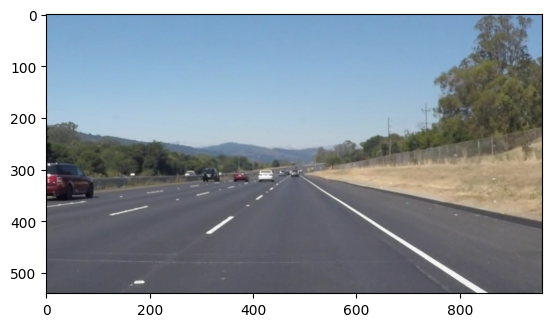

In [ ]:
#reading in an image
image = mpimg.imread('ML_CV_Teaching/lane_detection/test_images/solidWhiteRight.jpg')

#printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)

## Image Processing Example

### Set to grayscale

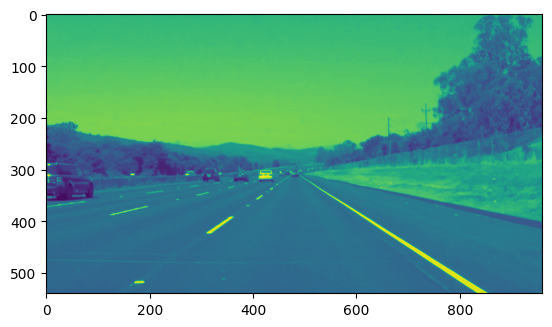

In [ ]:
imshape = image.shape

#Convert to grayscale
grayscaleImage = lp.grayscale(image)
plt.imshow(grayscaleImage)

### Gussian blur

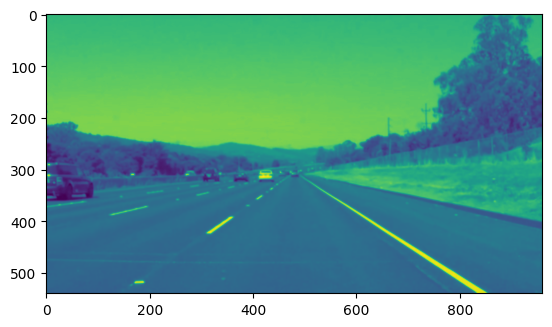

In [ ]:
#Apply gaussian blur
gaussianImage = lp.gaussian_blur(grayscaleImage, 5)
plt.imshow(gaussianImage)

### Show edges in the Image

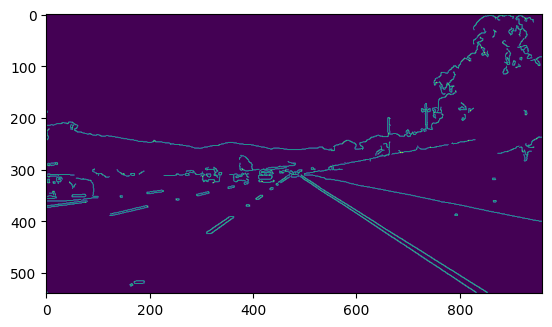

In [ ]:
#Find the edges in the image
cannyImage = lp.canny(gaussianImage, 50, 150)
plt.imshow(cannyImage)

### Remove unused edges

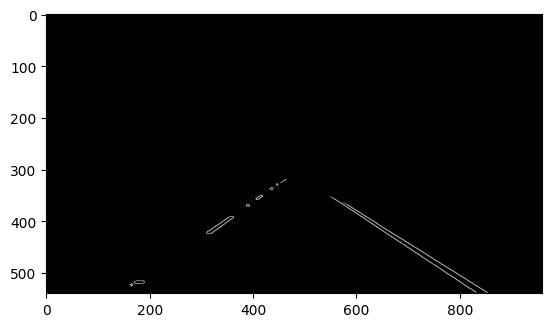

In [ ]:
#Limit to a region of interest, in this case the lanes
roiMask = lp.gen_roi_mask(imshape) #np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
edgeMask = lp.region_of_interest(cannyImage, roiMask)
#Only the required edges are displayed and rest is set to black
edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2BGR)
plt.imshow(edgeMaskImage)

### Highlight detected edges

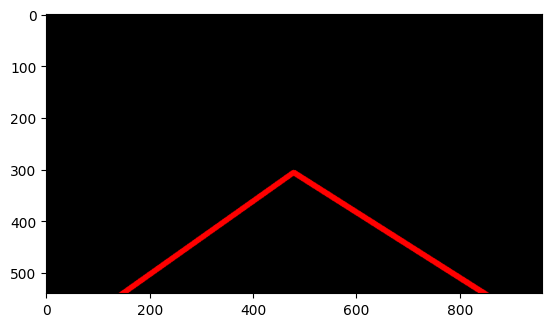

In [ ]:
#Hough lines transform to detect straight lines and then highlight the detected line
#rho = 2
#theta = np.pi/180
#threshold = 15
#min_line_len = 40
#max_line_gap = 20
linesImage = lp.hough_lines(edgeMask)
plt.imshow(linesImage)

### Add the Highlights back to image

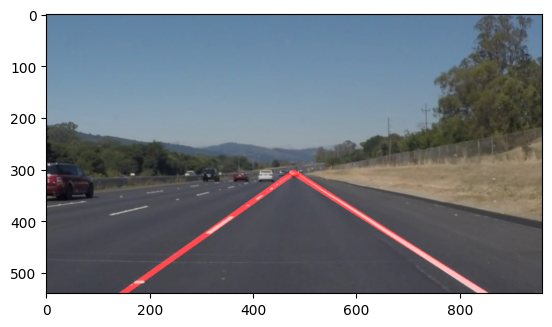

In [ ]:
marked_img = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
plt.imshow(marked_img)

## Define a function to do all the work


In [ ]:
def process_image(image):
    imshape = image.shape
    #Convert to grayscale
    grayscaleImage = lp.grayscale(image)

    #Apply gaussian blur
    gaussianImage = lp.gaussian_blur(grayscaleImage, 5)

    #Fine the edges in the image
    cannyImage = lp.canny(gaussianImage, 50, 150)

    #Limit to a region of interest, in this case the lanes
    roiMask = np.array([[(0, imshape[0]), (465, 320), (475, 320), (imshape[1], imshape[0])]], dtype=np.int32)
    edgeMask = lp.region_of_interest(cannyImage, roiMask)
    #Only the required edges are displayed and rest is set to black
    edgeMaskImage = cv2.cvtColor(edgeMask, cv2.COLOR_GRAY2BGR)

    #Hough lines
    rho = 2
    theta = np.pi/180
    threshold = 15
    min_line_len = 40
    max_line_gap = 20
    linesImage = lp.hough_lines(edgeMask, rho, theta, threshold, min_line_len, max_line_gap)

    result = cv2.addWeighted(image, 0.8, linesImage, 1, 0)
    return result


### Test this function

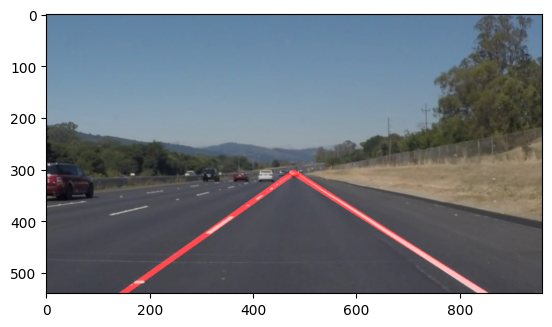

In [ ]:
marked_img = lp.process_image(image)
plt.imshow(marked_img)

## Process videos

We will extract each frame of a video to detect the lane in the video

### Add a few more libraries

In [ ]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

### Load first video

In [ ]:
clip1_path = 'ML_CV_Teaching/lane_detection/test_videos/solidWhiteRight.mp4'
clip1 = VideoFileClip(clip1_path)
lp.playvideo(clip1_path)
#clip1.ipython_display(clip1)

### Process the first video

In [ ]:
# set output file name
clip1_output = 'clip1_out.mp4'

# use "process_image" function to process very frame in clip1
clip1_marked = clip1.fl_image(lp.process_image)

# save the marked clip1
%time clip1_marked.write_videofile(clip1_output, audio=False)

# show marked clip1
#clip1.ipython_display(clip1_marked)
lp.playvideo(clip1_output)

Moviepy - Building video clip1_out.mp4.
Moviepy - Writing video clip1_out.mp4



Moviepy - Done !
Moviepy - video ready clip1_out.mp4
CPU times: user 2.82 s, sys: 445 ms, total: 3.26 s
Wall time: 14 s


### Load the second Video

In [ ]:
clip2_path = 'ML_CV_Teaching/lane_detection/test_videos/solidYellowLeft.mp4'
clip2 = VideoFileClip(clip2_path)
lp.playvideo(clip2_path)


### Process the second video

In [ ]:
# set output file name
clip2_output = 'clip2_out.mp4'

# use "process_image" function to process very frame in clip1
clip2_marked = clip2.fl_image(lp.process_image)

# save the marked clip1
%time clip2_marked.write_videofile(clip2_output, audio=False)

# show marked clip1
#clip1.ipython_display(clip1_marked)
lp.playvideo(clip2_output)

Moviepy - Building video clip2_out.mp4.
Moviepy - Writing video clip2_out.mp4



t:   1%|          | 7/681 [00:00<00:09, 68.15it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,

  ret = ret.dtype.type(ret / rcount)

  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,

  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',

  ret = ret.dtype.type(ret / rcount)



Moviepy - Done !
Moviepy - video ready clip2_out.mp4
CPU times: user 9.13 s, sys: 1.39 s, total: 10.5 s
Wall time: 45.5 s


## Update Git Repo

In [ ]:
!cd ExploreSTEM/; git pull origin master

/bin/bash: line 0: cd: ExploreSTEM/: No such file or directory
fatal: not a git repository (or any of the parent directories): .git
